<a href="https://colab.research.google.com/github/JHyunjun/TF2.0_Pix2Pix/blob/main/pix2pix_tensorflow_(1).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# 드라이브에 접근할 수 있도록 아래 코드 입력
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import tensorflow as tf

import os
import time

from matplotlib import pyplot as plt
from IPython import display

import os
import librosa
import math
import numpy as np
import pydot

from skimage.io import imshow

In [ ]:
#%%
clean_path = '/content/drive/MyDrive/Colab Notebooks/pix2pix/clean/'
noise_path = '/content/drive/MyDrive/Colab Notebooks/pix2pix/noise/'

clean_list = os.listdir(clean_path)
noise_list = os.listdir(noise_path)

clean_list.sort()
noise_list.sort()

In [ ]:
print(noise_list)
print(clean_list)

['Mix_Audio_00000.wav', 'Mix_Audio_00001.wav', 'Mix_Audio_00002.wav', 'Mix_Audio_00003.wav', 'Mix_Audio_00004.wav', 'Mix_Audio_00005.wav', 'Mix_Audio_00006.wav', 'Mix_Audio_00007.wav', 'Mix_Audio_00008.wav', 'Mix_Audio_00009.wav', 'Mix_Audio_00010.wav', 'Mix_Audio_00011.wav', 'Mix_Audio_00012.wav', 'Mix_Audio_00013.wav', 'Mix_Audio_00014.wav', 'Mix_Audio_00015.wav', 'Mix_Audio_00016.wav', 'Mix_Audio_00017.wav', 'Mix_Audio_00018.wav', 'Mix_Audio_00019.wav', 'Mix_Audio_00020.wav', 'Mix_Audio_00021.wav', 'Mix_Audio_00022.wav', 'Mix_Audio_00023.wav', 'Mix_Audio_00024.wav', 'Mix_Audio_00025.wav', 'Mix_Audio_00026.wav', 'Mix_Audio_00027.wav', 'Mix_Audio_00028.wav', 'Mix_Audio_00029.wav', 'Mix_Audio_00030.wav', 'Mix_Audio_00031.wav', 'Mix_Audio_00032.wav', 'Mix_Audio_00033.wav', 'Mix_Audio_00034.wav', 'Mix_Audio_00035.wav', 'Mix_Audio_00036.wav', 'Mix_Audio_00037.wav', 'Mix_Audio_00038.wav', 'Mix_Audio_00039.wav', 'Mix_Audio_00040.wav', 'Mix_Audio_00041.wav', 'Mix_Audio_00042.wav', 'Mix_Audio

In [ ]:
#%%
def normalization(noise, clean, a, b, Max, Min):
    clean_normal = ((b - a)*(clean - Min)) / (Max - Min) + a
    noise_normal = ((b - a)*(noise - Min)) / (Max - Min) + a
    return noise_normal, clean_normal

def denormalization(data, a, b, Max, Min): # GAN 값 도출 이후 역정규화를 통해 STFT로 변환하기 위한 함수
    denorm = ((data - a) * (Max - Min))/(b - a) + Min
    return denorm

In [ ]:
#%%
hop_length = 257  # number of samples per time-step in spectrogram
n_fft = 510

noise = np.zeros((len(noise_list), 256, 256, 2)).astype('float32')
clean = np.zeros((len(clean_list), 256, 256, 2)).astype('float32')

mag_max = []
mag_min = []
ang_max = []
ang_min = []

for i in range(len(noise)):
    noi, sr = librosa.load(noise_path + noise_list[i], sr=16384)
    cle, sr = librosa.load(clean_path + clean_list[i], sr=16384)

    stft_noise = librosa.stft(noi, n_fft=n_fft, hop_length=hop_length)
    stft_clean = librosa.stft(cle, n_fft=n_fft, hop_length=hop_length)
    
    magnitude_noise = np.abs(stft_noise)
    magnitude_clean = np.abs(stft_clean)
    
    log_magnitude_noise = librosa.amplitude_to_db(magnitude_noise)
    log_magnitude_clean = librosa.amplitude_to_db(magnitude_clean)

    angle_noise = np.unwrap(np.angle(stft_noise))
    angle_clean = np.unwrap(np.angle(stft_clean))

    mag_max.append(np.max((log_magnitude_noise, log_magnitude_clean)))
    mag_min.append(np.min((log_magnitude_noise, log_magnitude_clean)))

    ang_max.append(np.max((angle_noise, angle_clean)))
    ang_min.append(np.min((angle_noise, angle_clean)))

    log_magnitude_noise, log_magnitude_clean = normalization(log_magnitude_noise, log_magnitude_clean, -1, 1, np.max((log_magnitude_noise, log_magnitude_clean)), np.min((log_magnitude_noise, log_magnitude_clean)))

    angle_noise, angle_clean = normalization(angle_noise, angle_clean, -1, 1, np.max((angle_noise, angle_clean)), np.min((angle_noise, angle_clean)))
    
    noise[i,:,:,0] = log_magnitude_noise.astype('float32')
    clean[i,:,:,0] = log_magnitude_clean.astype('float32')
    
    noise[i,:,:,1] = angle_noise.astype('float32')
    clean[i,:,:,1] = angle_clean.astype('float32')

In [ ]:
#%%
BUFFER_SIZE = 400
BATCH_SIZE = 1
IMG_WIDTH = 256
IMG_HEIGHT = 256

In [ ]:
#%%
noise_train = noise[:len(noise_list) - 40,:,:,:]
clean_train = clean[:len(clean_list) - 40,:,:,:]

noise_test = noise[len(noise_list) - 40:,:,:,:]
clean_test = clean[len(clean_list) - 40:,:,:,:]

In [ ]:
train_dataset = tf.data.Dataset.from_tensor_slices((noise_train,clean_train))
print(train_dataset)
#train_dataset = train_dataset.shuffle(BUFFER_SIZE)
train_dataset = train_dataset.batch(BATCH_SIZE)

<TensorSliceDataset shapes: ((256, 256, 2), (256, 256, 2)), types: (tf.float32, tf.float32)>


In [ ]:
#%%
test_dataset = tf.data.Dataset.from_tensor_slices((noise_test,clean_test))
print(test_dataset)
# test_dataset = test_dataset.shuffle(BUFFER_SIZE)
test_dataset = test_dataset.batch(BATCH_SIZE)

<TensorSliceDataset shapes: ((256, 256, 2), (256, 256, 2)), types: (tf.float32, tf.float32)>


In [ ]:
OUTPUT_CHANNELS = 2

In [ ]:
#%%
def downsample(filters, size, apply_batchnorm=True):
  initializer = tf.random_normal_initializer(0., 0.02)

  result = tf.keras.Sequential()
  result.add(
      tf.keras.layers.Conv2D(filters, size, strides=2, padding='same', # stride = 2로 인해서 이미지의 사이즈가 반으로 줄어든다.
                             kernel_initializer=initializer, use_bias=False))

  if apply_batchnorm:
    result.add(tf.keras.layers.BatchNormalization())

  result.add(tf.keras.layers.LeakyReLU())

  return result

In [ ]:
#%%
def upsample(filters, size, apply_dropout=False):
  initializer = tf.random_normal_initializer(0., 0.02)

  result = tf.keras.Sequential()
  result.add(
    tf.keras.layers.Conv2DTranspose(filters, size, strides=2,
                                    padding='same',
                                    kernel_initializer=initializer,
                                    use_bias=False))

  result.add(tf.keras.layers.BatchNormalization())

  if apply_dropout:
      result.add(tf.keras.layers.Dropout(0.5))

  result.add(tf.keras.layers.ReLU())

  return result

In [ ]:
#%%
def Generator():
  inputs = tf.keras.layers.Input(shape=[256,256,2])

  down_stack = [
    downsample(64, 4, apply_batchnorm=False), # (bs, 128, 128, 64)
    downsample(128, 4), # (bs, 64, 64, 128)
    downsample(256, 4), # (bs, 32, 32, 256)
    downsample(512, 4), # (bs, 16, 16, 512)
    downsample(512, 4), # (bs, 8, 8, 512)
    downsample(512, 4), # (bs, 4, 4, 512)
    downsample(512, 4), # (bs, 2, 2, 512)
    downsample(512, 4), # (bs, 1, 1, 512)
  ]

  up_stack = [
    upsample(512, 4, apply_dropout=True), # (bs, 2, 2, 1024)
    upsample(512, 4, apply_dropout=True), # (bs, 4, 4, 1024)
    upsample(512, 4, apply_dropout=True), # (bs, 8, 8, 1024)
    upsample(512, 4), # (bs, 16, 16, 1024)
    upsample(256, 4), # (bs, 32, 32, 512)
    upsample(128, 4), # (bs, 64, 64, 256)
    upsample(64, 4), # (bs, 128, 128, 128)
  ]

  initializer = tf.random_normal_initializer(0., 0.02)
  last = tf.keras.layers.Conv2DTranspose(OUTPUT_CHANNELS, 4,
                                         strides=2,
                                         padding='same',
                                         kernel_initializer=initializer,
                                         activation='tanh') # (bs, 256, 256, 2)

  x = inputs

  # Downsampling through the model
  skips = []
  for down in down_stack:
    x = down(x)
    skips.append(x)

  skips = reversed(skips[:-1])

  # Upsampling and establishing the skip connections
  for up, skip in zip(up_stack, skips):
    x = up(x)
    x = tf.keras.layers.Concatenate()([x, skip])

  x = last(x)

  return tf.keras.Model(inputs=inputs, outputs=x)

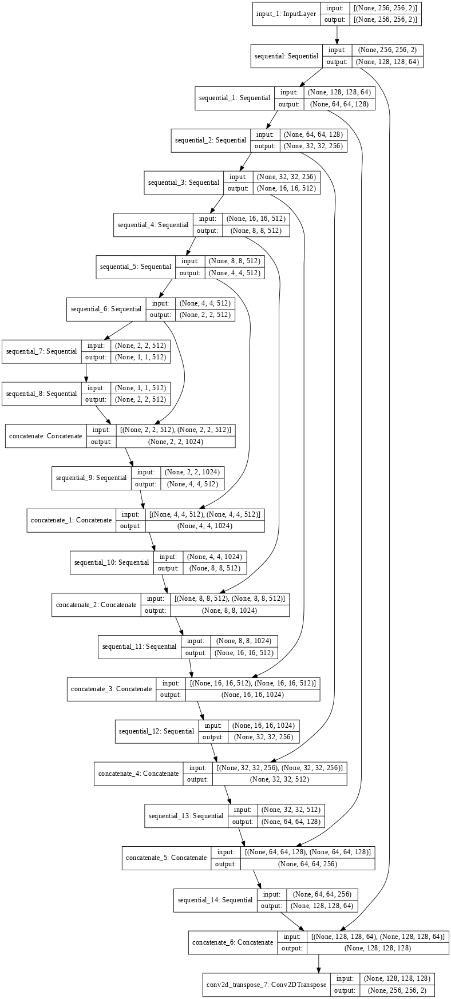

In [ ]:
#%%
generator = Generator()
tf.keras.utils.plot_model(generator, show_shapes=True, dpi=64)

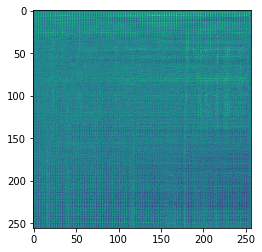

In [ ]:
#%%
inp, _ = noise_train, clean_train
gen_output = generator(inp[0][tf.newaxis,...], training=False)
plt.imshow(gen_output[0,:,:,1])

In [ ]:
LAMBDA = 100
loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [ ]:
#%%
def generator_loss(disc_generated_output, gen_output, target):
  gan_loss = loss_object(tf.ones_like(disc_generated_output), disc_generated_output)

  # mean absolute error
  l1_loss = tf.reduce_mean(tf.abs(target - gen_output))

  total_gen_loss = gan_loss + (LAMBDA * l1_loss)

  return total_gen_loss, gan_loss, l1_loss

In [ ]:
#%%
def Discriminator():
  initializer = tf.random_normal_initializer(0., 0.02)

  inp = tf.keras.layers.Input(shape=[256, 256, 2], name='input_image')
  tar = tf.keras.layers.Input(shape=[256, 256, 2], name='target_image')

  x = tf.keras.layers.concatenate([inp, tar]) # (bs, 256, 256, channels*2)

  down1 = downsample(64, 4, False)(x) # (bs, 128, 128, 64)
  down2 = downsample(128, 4)(down1) # (bs, 64, 64, 128)
  down3 = downsample(256, 4)(down2) # (bs, 32, 32, 256)

  zero_pad1 = tf.keras.layers.ZeroPadding2D()(down3) # (bs, 34, 34, 256)
  conv = tf.keras.layers.Conv2D(512, 4, strides=1,
                                kernel_initializer=initializer,
                                use_bias=False)(zero_pad1) # (bs, 31, 31, 512)

  batchnorm1 = tf.keras.layers.BatchNormalization()(conv)

  leaky_relu = tf.keras.layers.LeakyReLU()(batchnorm1)

  zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu) # (bs, 33, 33, 512)

  last = tf.keras.layers.Conv2D(1, 4, strides=1,
                                kernel_initializer=initializer)(zero_pad2) # (bs, 30, 30, 1)

  return tf.keras.Model(inputs=[inp, tar], outputs=last)

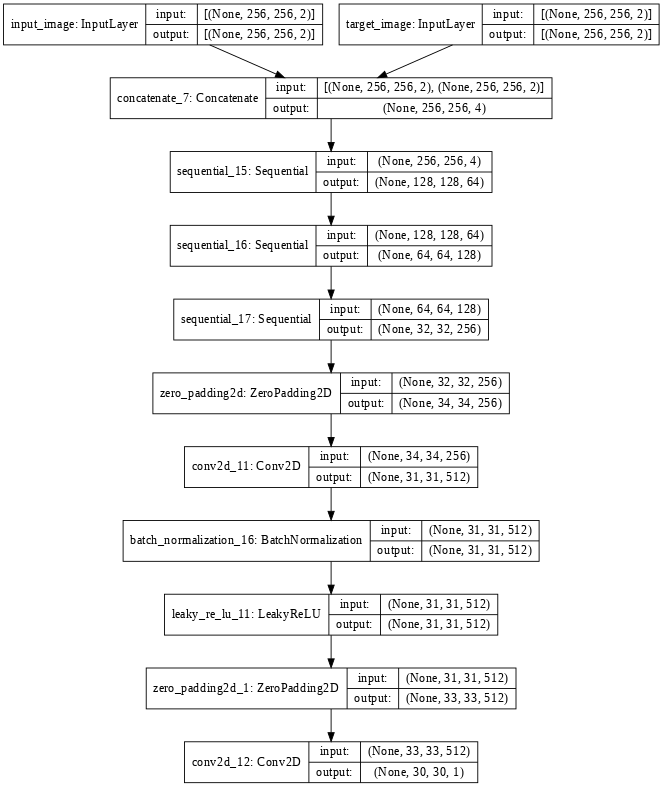

In [ ]:
#%%
discriminator = Discriminator()
tf.keras.utils.plot_model(discriminator, show_shapes=True, dpi=64)

In [ ]:
#%%
def discriminator_loss(disc_real_output, disc_generated_output):
  real_loss = loss_object(tf.ones_like(disc_real_output), disc_real_output)

  generated_loss = loss_object(tf.zeros_like(disc_generated_output), disc_generated_output)

  total_disc_loss = real_loss + generated_loss

  return total_disc_loss

In [ ]:
#%%
generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

In [ ]:
#%%
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

In [ ]:
#%%
def generate_images(model, test_input, tar):
  prediction = model(test_input, training=True)
  plt.figure(figsize=(15,15))

  mag_list = [test_input[0][:,:,0], tar[0][:,:,0], prediction[0][:,:,0]]
  title = ['Input Magnitude', 'Ground Truth', 'Predicted Image']

  for i in range(3):
    plt.subplot(1, 3, i+1)
    plt.title(title[i])
    # getting the pixel values between [0, 1] to plot it.
    plt.imshow(mag_list[i] * 0.5 + 0.5)
    plt.axis('off')
  plt.show()

  plt.figure(figsize=(15,15))

  ang_list = [test_input[0][:,:,1], tar[0][:,:,1], prediction[0][:,:,1]]
  title = ['Input Angle', 'Ground Truth', 'Predicted Image']

  for i in range(3):
    plt.subplot(1, 3, i+1)
    plt.title(title[i])
    # getting the pixel values between [0, 1] to plot it.
    plt.imshow(ang_list[i] * 0.5 + 0.5)
    plt.axis('off')
  plt.show()

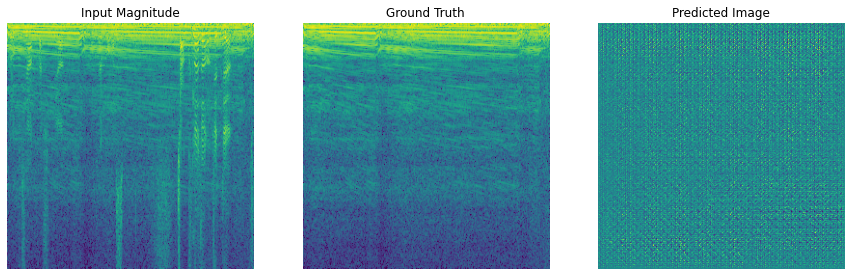

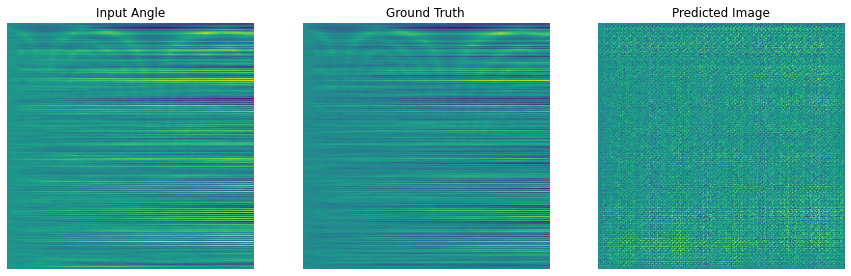

In [ ]:
#%%
for example_input, example_target in train_dataset.take(1):
  generate_images(generator, example_input, example_target)

In [ ]:
#%%
EPOCHS = 30
#%%
import datetime
log_dir="logs/"

summary_writer = tf.summary.create_file_writer(
  log_dir + "fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))

In [ ]:
#%%
@tf.function
def train_step(input_image, target, epoch):
  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    gen_output = generator(input_image, training=True)

    disc_real_output = discriminator([input_image, target], training=True)
    disc_generated_output = discriminator([input_image, gen_output], training=True)

    gen_total_loss, gen_gan_loss, gen_l1_loss = generator_loss(disc_generated_output, gen_output, target)
    disc_loss = discriminator_loss(disc_real_output, disc_generated_output)

  generator_gradients = gen_tape.gradient(gen_total_loss,
                                          generator.trainable_variables)
  discriminator_gradients = disc_tape.gradient(disc_loss,
                                               discriminator.trainable_variables)

  generator_optimizer.apply_gradients(zip(generator_gradients,
                                          generator.trainable_variables))
  discriminator_optimizer.apply_gradients(zip(discriminator_gradients,
                                              discriminator.trainable_variables))

  with summary_writer.as_default():
    tf.summary.scalar('gen_total_loss', gen_total_loss, step=epoch)
    tf.summary.scalar('gen_gan_loss', gen_gan_loss, step=epoch)
    tf.summary.scalar('gen_l1_loss', gen_l1_loss, step=epoch)
    tf.summary.scalar('disc_loss', disc_loss, step=epoch)

In [ ]:
#%%
def fit(train_ds, epochs, test_ds):
  for epoch in range(epochs):
    start = time.time()

    display.clear_output(wait=True)

    for example_input, example_target in test_ds.take(1):
      generate_images(generator, example_input, example_target)
    print("Epoch: ", epoch)

    # Train
    for n, (input_image, target) in train_ds.enumerate():
      print('.', end='')
      if (n+1) % 100 == 0:
        print()
      train_step(input_image, target, epoch)
    print()

    # saving (checkpoint) the model every 20 epochs
    if (epoch + 1) % 20 == 0:
      checkpoint.save(file_prefix = checkpoint_prefix)

    print ('Time taken for epoch {} is {} sec\n'.format(epoch + 1,
                                                        time.time()-start))
  checkpoint.save(file_prefix = checkpoint_prefix)  

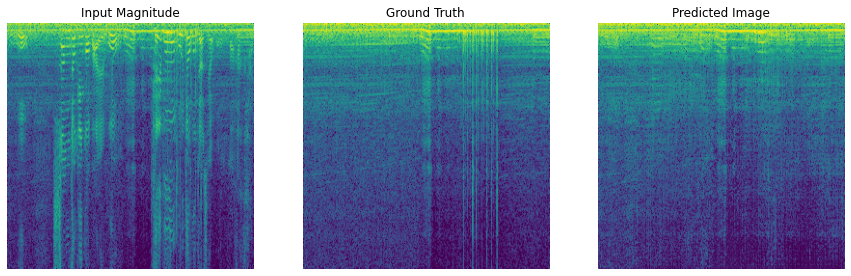

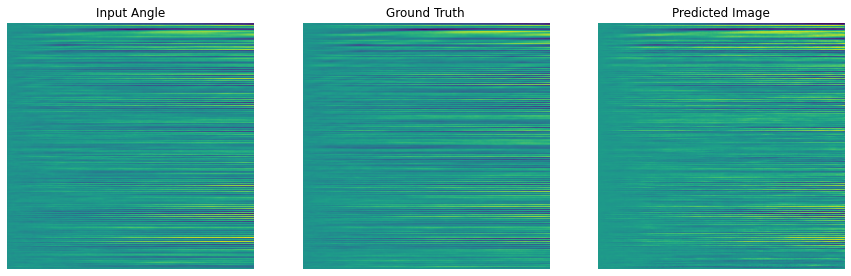

Epoch:  29
....................................................................................................
....................................................................................................
....................................................................................................
............................................................
Time taken for epoch 30 is 34.704630613327026 sec



In [ ]:
#%%
fit(train_dataset, EPOCHS, test_dataset)

In [ ]:
%load_ext tensorboard

In [ ]:
%tensorboard --logdir {log_dir}

<IPython.core.display.Javascript object>

In [ ]:
ls {checkpoint_dir}

checkpoint                  ckpt-1.index                ckpt-2.index
ckpt-1.data-00000-of-00001  ckpt-2.data-00000-of-00001


In [ ]:
# restoring the latest checkpoint in checkpoint_dir
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

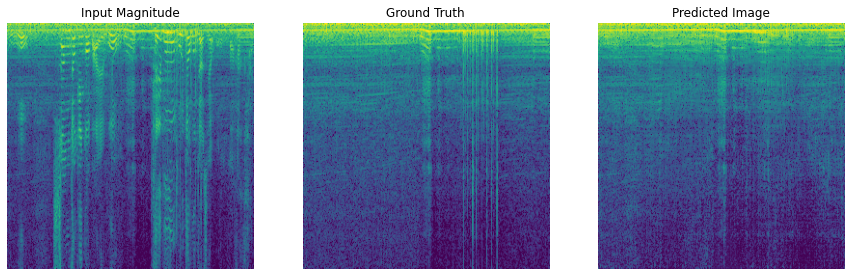

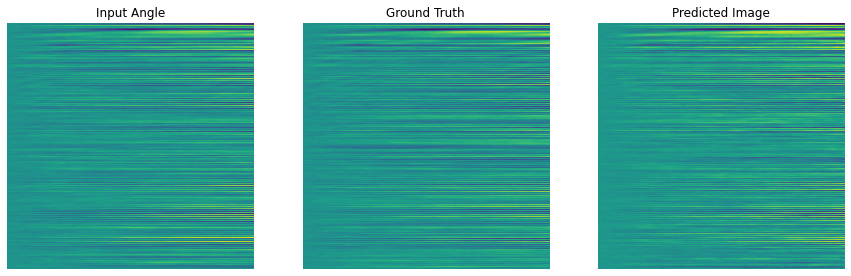

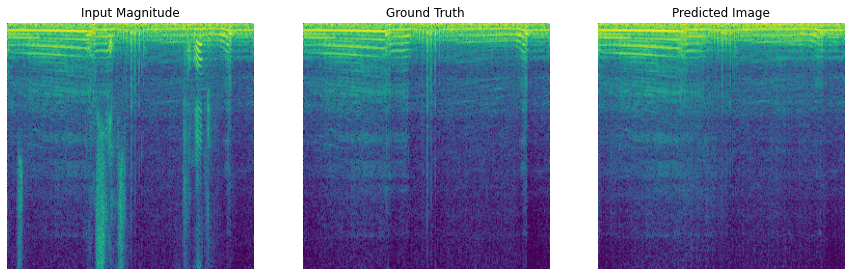

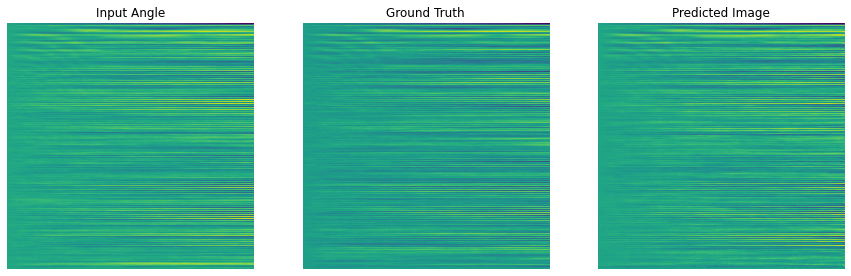

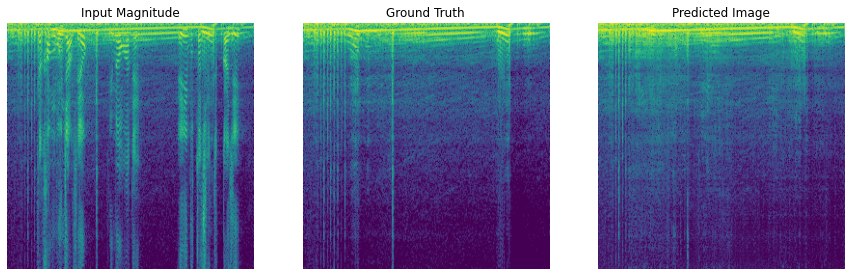

...

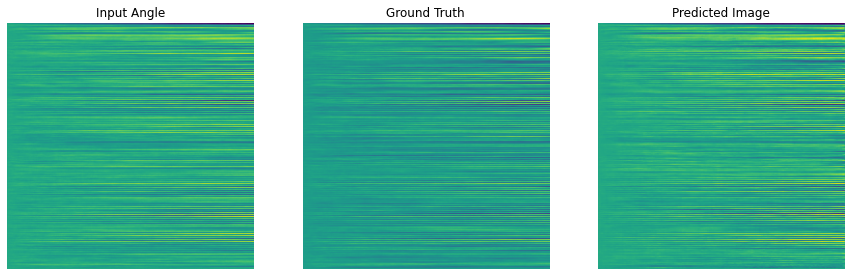

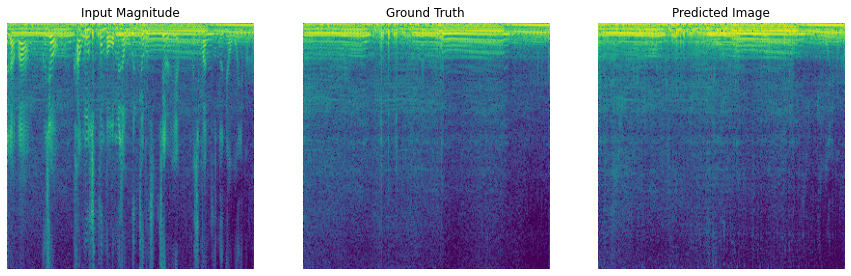

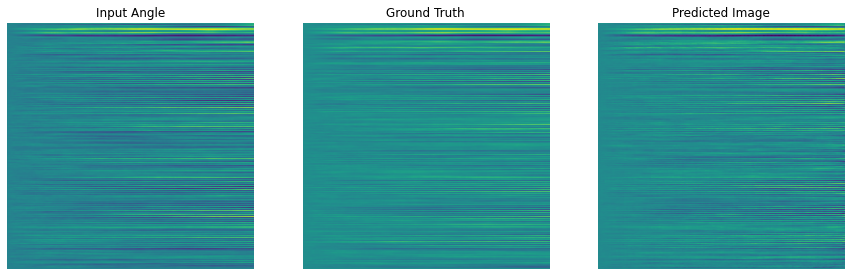

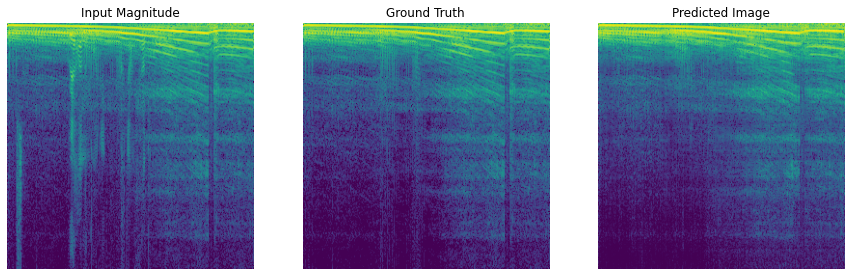

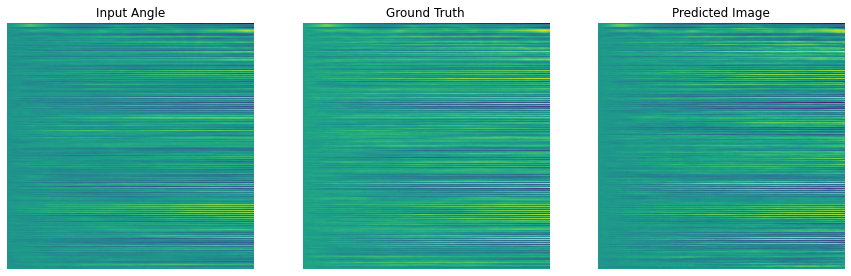

In [ ]:
# Run the trained model on a few examples from the test dataset
for inp, tar in test_dataset.take(10):
  generate_images(generator, inp, tar)

In [ ]:
def unwrap_to_ang(unwrap):
    pi = 3.1415927410125732
    
    for i in range(1, int(np.max(unwrap) // pi + 2), 2):
        plus = (((i+2)*pi) >= unwrap) & (unwrap > (i*pi))
        minus = (unwrap >= (-(i+2)*pi)) & (unwrap < (-i*pi))
    
        unwrap[plus] -= (i+1)*pi
        unwrap[minus] += (i+1)*pi
    
    return unwrap

In [ ]:
#%%
def mag_ang_to_stft(mag, ang):
    pi  = 3.1415927
    half = pi / 2
    
    over = ang > half
    lower = ang < -half
    plus = ((0 <= ang) & (ang <= half))
    minus = ((0 > ang) & (ang >= -half))
    
    ang_list = [plus, minus, over, lower]
    
    stft = np.zeros((256,256)).astype('complex64')
    

    for idx, i in enumerate(ang_list):
        
        real = mag[i]*np.cos(ang[i])
        imag = mag[i]*np.sin(ang[i])*complex(0,1)
        
        real_1 = mag[i]*np.cos(-ang[i])
        imag_1 = mag[i]*np.sin(-ang[i])*complex(0,1)
        
        real_2 = mag[i]*np.cos(pi - ang[i])
        imag_2 = mag[i]*np.sin(pi - ang[i])*complex(0,1)

        real_3 = mag[i]*np.cos(pi + ang[i])
        imag_3 = mag[i]*np.sin(pi + ang[i])*complex(0,1)
        
        if idx == 0:
            stft[i] = real + imag
        elif idx == 1:
            stft[i] = real_1 - imag_1
        elif idx == 2:
            stft[i] = -real_2 + imag_2
        elif idx == 3:
            stft[i] = -real_3 - imag_3
    
    return stft

In [ ]:
#%% 모델이 예측해낸 magnitude와 angle을 기반으로 음성 추출
import soundfile

count = 360
time = 940
#cnt = 0
for inp, tar in test_dataset.take(40):
  #cnt += 1
  prediction = generator(inp, training = True)
  max_mag_clean = mag_max[count]
  min_mag_clean = mag_min[count]

  max_ang_clean = ang_max[count]
  min_ang_clean = ang_min[count]

  gen_mag = np.array(prediction[0][:,:,0])
  gen_ormag = np.array(inp[0][:,:,0])
  gt_mag = np.array(tar[0][:,:,0])

  gen_ang = np.array(prediction[0][:,:,1])
  gen_orang = np.array(inp[0][:,:,1])
  gt_ang = np.array(tar[0][:,:,1])

  #print("prediction[0] : ",prediction[0].shape) # 256,256,2
  #print("inp[0] : ", inp[0].shape) #256,256,2
  #print("tar[0] :  ", tar[0].shape) #256,256,2

  gen_mag_denorm = denormalization(gen_mag, -1, 1, max_mag_clean, min_mag_clean)
  gen_ormag_denorm = denormalization(gen_ormag, -1, 1, max_mag_clean, min_mag_clean)
  gt_mag_denorm = denormalization(gt_mag, -1, 1, max_mag_clean, min_mag_clean)

  gen_ang_denorm = denormalization(gen_ang, -1, 1, max_ang_clean, min_ang_clean)
  gen_orang_denorm = denormalization(gen_orang, -1, 1, max_ang_clean, min_ang_clean)
  gt_ang_denorm = denormalization(gt_ang, -1, 1, max_ang_clean, min_ang_clean)

  #globals()["gen_mag_{}".format(cnt)] = np.ndarray.zeros()
  #globals()["gen_mag_{}".format(cnt)] = gen_ang_denorm
  
  #print("gen_mag_denorm : ",gen_mag_denorm.shape) #256,256 : Magnitude
  #print("gen_ang_denorm : ",gen_ang_denorm.shape) #256,256 : Angle
  #print(gen_mag_denorm)
  #print(gen_mag_denorm[1,1])
  #print(count)

  gen_db_amp = librosa.db_to_amplitude(gen_mag_denorm)
  gen_org_db_amp = librosa.db_to_amplitude(gen_ormag_denorm)
  gt_db_amp = librosa.db_to_amplitude(gt_mag_denorm)
  #print("gen_org_db_amp : ", gen_org_db_amp)
  #print("gen_db_amp : ",gen_db_amp.shape) #256,256
  #print(gen_db_amp)
  #print(gen_db_amp[0,0])
  #print("Original : ",gen_ang_denorm)
  mag_array = np.zeros((1,256))
  phase_array = np.zeros((1,256))

  #print(gen_db_amp)
  #print(np.abs(gen_db_amp[0,0]))
  for i in range(256) : # 0~255만큼 움직임 array도 0~255
    sum = 0
    for j in range(256) :
      sum += np.abs(gen_ormag_denorm[j,i] - gen_mag_denorm[j,i]) #Magnitude는 모두 양수임
      mag_array[0,i] = sum
  mag_min_pos = np.argmin(mag_array)
  print("Mag_min_pos : ",mag_min_pos)

  for i in range(256) : 
         phase_array[0,i] = gen_orang_denorm[i,mag_min_pos] - gen_ang_denorm[i,mag_min_pos]
  
  for i in range(256) : 
    for j in range(256) : 
      gen_ang_denorm[j,i] = gen_ang_denorm[j,i] + phase_array[0,i]

  gen_unwrap_ang = unwrap_to_ang(gen_ang_denorm)
  gen_unwrap_orang = unwrap_to_ang(gen_orang_denorm)
  gt_unwrap_ang = unwrap_to_ang(gt_ang_denorm)

  mag_array = np.zeros((1,256))
  phase_array = np.zeros((1,256))

  gen_stft = mag_ang_to_stft(gen_db_amp, gen_unwrap_ang)
  gen_orstft = mag_ang_to_stft(gen_db_amp, gen_unwrap_orang)
  gt_stft = mag_ang_to_stft(gt_db_amp, gt_unwrap_ang)

  gen_wav = librosa.istft(gen_stft, hop_length = hop_length, win_length=n_fft)
  gen_orwav = librosa.istft(gen_orstft, hop_length = hop_length, win_length=n_fft)
  gt_wav = librosa.istft(gt_stft, hop_length = hop_length, win_length=n_fft)
  count += 1

  soundfile.write('/content/drive/MyDrive/Colab Notebooks/pix2pix/revised_210806/gen_wav_{}.wav' .format(count), gen_wav, sr)
  soundfile.write('/content/drive/MyDrive/Colab Notebooks/pix2pix/revised_210806/gen_org_wav_{}.wav' .format(count), gen_orwav, sr)
  soundfile.write('/content/drive/MyDrive/Colab Notebooks/pix2pix/revised_210806/gt_wav_{}.wav' .format(count), gt_wav, sr)



Mag_min_pos :  22
Mag_min_pos :  57
Mag_min_pos :  165
Mag_min_pos :  152
Mag_min_pos :  135
Mag_min_pos :  89
Mag_min_pos :  246
Mag_min_pos :  201
Mag_min_pos :  33
Mag_min_pos :  43
Mag_min_pos :  26
Mag_min_pos :  70
Mag_min_pos :  145
Mag_min_pos :  24
Mag_min_pos :  151
Mag_min_pos :  167
Mag_min_pos :  167
Mag_min_pos :  182
Mag_min_pos :  186
Mag_min_pos :  229
Mag_min_pos :  131
Mag_min_pos :  26
Mag_min_pos :  78
Mag_min_pos :  40
Mag_min_pos :  28
Mag_min_pos :  102
Mag_min_pos :  51
Mag_min_pos :  25
Mag_min_pos :  17
Mag_min_pos :  124
Mag_min_pos :  134
Mag_min_pos :  117
Mag_min_pos :  181
Mag_min_pos :  38
Mag_min_pos :  89
Mag_min_pos :  183
Mag_min_pos :  215
Mag_min_pos :  101
Mag_min_pos :  74
Mag_min_pos :  21


In [ ]:
#%% 모델이 예측해낸 magnitude만 가지고 librosa의 griffinlim을 이용하여 음성 추출
import soundfile

count = 560

for inp, tar in test_dataset.take(40):
  prediction = generator(inp, training = True)
  max_clean = mag_max[count]
  min_clean = mag_min[count]

  gen_mag = prediction[0][:,:,0]
  gt_mag = tar[0][:,:,0]

  gen_denorm = denormalization(gen_mag, -1, 1, max_clean, min_clean)
  gt_denorm = denormalization(gt_mag, -1, 1, max_clean, min_clean)

  gen_db_amp = librosa.db_to_amplitude(gen_denorm)
  gt_db_amp = librosa.db_to_amplitude(gt_denorm)

  # gen_wav = librosa.istft(gen_db_amp, hop_length = hop_length, win_length=n_fft)
  # gt_wav = librosa.istft(gt_db_amp, hop_length = hop_length, win_length=n_fft)

  gen_wav = librosa.griffinlim(gen_db_amp, hop_length = hop_length, win_length=n_fft)
  gt_wav = librosa.griffinlim(gt_db_amp, hop_length = hop_length, win_length=n_fft)

  soundfile.write('/content/drive/MyDrive/gen_wav_griffin/gen_wav_{}.wav' .format(count), gen_wav, sr)
#   soundfile.write('/content/drive/MyDrive/gt_wav/gt_wav_{}.wav' .format(count), gt_wav, sr)

  count += 1

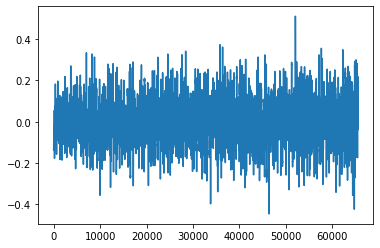

In [ ]:
plt.plot(gen_wav)
plt.show()

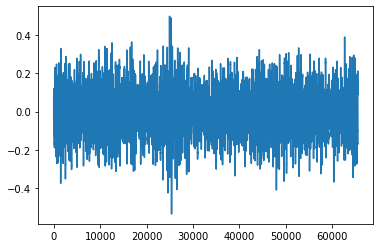

In [ ]:
plt.plot(gt_wav)
plt.show()

In [ ]:
gen_mag_0